# Analytical Flow-Matching

This notebook explores the closed-form solution of flow-matching.

The equations are used to solve a flow-matching problem in 2 dimensions, and we compare with the machine learning solution. We visualize the results and numerically compute the theoretical minimum loss.

# Closed-Form Solution

For the case of initial Gaussian noise being transformed into distribution described by a set of discrete observations $\vec{\mu}_j$ and a linear schedule $\alpha = 1 - t, \beta = t$, the velocity field is given by

\begin{equation}
\vec{v} (\vec{x}, t) = \frac{1}{1 - t}\left( \sum_j \vec{\mu}_{j} \cdot 
\text{softmax}_{\vec{\mu}_j}\left(-\frac{1}{2} \frac{\left(\vec{x} - \vec{\mu}_{j} t \right)^2}{(1 - t)^2 \sigma_i} \right) - \vec{x} \right)
\end{equation}

where $\sigma_i$ is the initial variance.

# In Python

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import time

import torch
import torch.nn.functional as F
from torch import nn, Tensor

# Importing our existing flow funcs
import os
import sys
from pathlib import Path
# Add parent directory to sys.path
parent_dir = Path.cwd().parent.parent
sys.path.append(str(parent_dir))
# Import modules
from analytic_flow_funcs import compute_linear_velocity_batch, forward_euler_integration_analytic_linear

# Distribution Generation

We generate and visualize our input and output distributions that we want to flow from.

For the analytical solution derived above, the input distribution must always be an n-dimensional independent Gaussian, but our output can be arbitrary.

## Checkerboard Distribution

In [2]:
def generate_checkerboard(num_points, grid_size=3, scale=5.0, device='cpu'):
    """
    Generate points from a checkerboard distribution.
    
    Args:
        num_points: number of points to generate
        grid_size: number of checkers per dimension (default: 3)
        scale: range of the distribution will be [-scale, scale] (default: 5.0)
        device: device to put the tensor on (default: 'cpu')
    
    Returns:
        torch.Tensor: shape (num_points, 2) with checkerboard pattern samples
    """
    grid_length = 2 * scale / grid_size
    samples = torch.zeros(0, 2).to(device)
    
    while samples.shape[0] < num_points:
        # Sample more points than needed to account for rejection
        new_samples = (torch.rand(num_points, 2).to(device) - 0.5) * 2 * scale
        x_mask = torch.floor((new_samples[:, 0] + scale) / grid_length) % 2 == 0
        y_mask = torch.floor((new_samples[:, 1] + scale) / grid_length) % 2 == 0
        accept_mask = torch.logical_xor(~x_mask, y_mask)
        samples = torch.cat([samples, new_samples[accept_mask]], dim=0)
    
    return samples[:num_points]

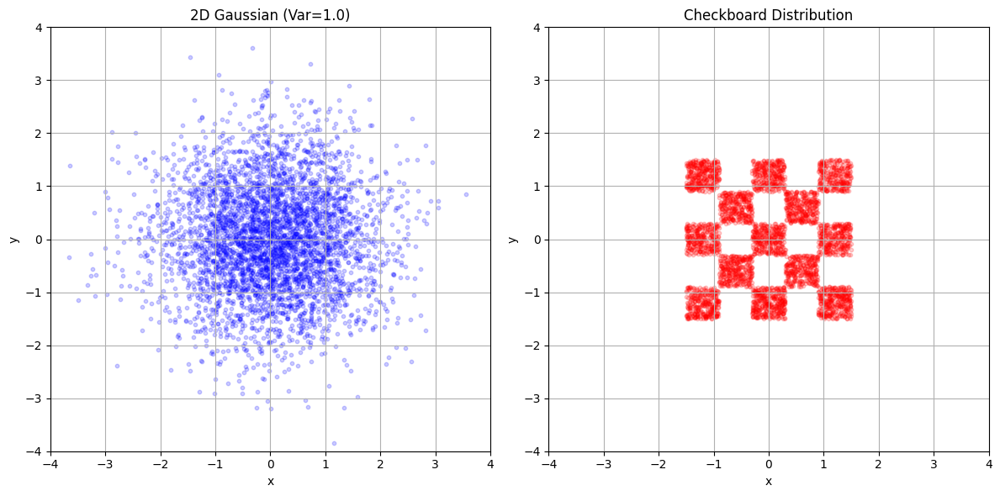

torch.Size([4000, 2])


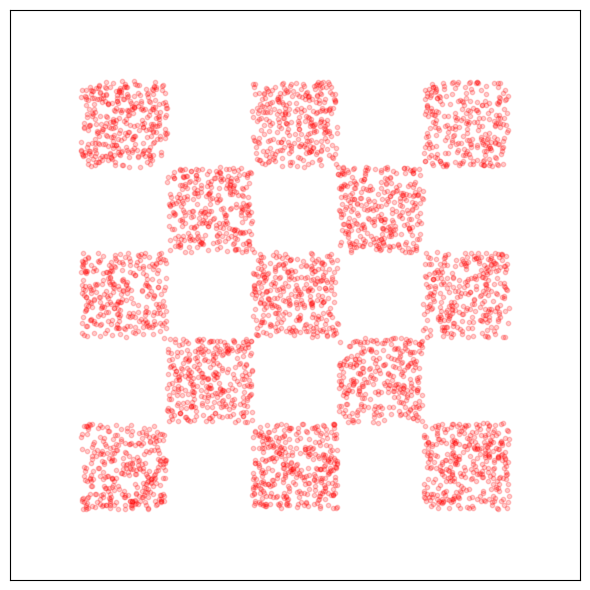

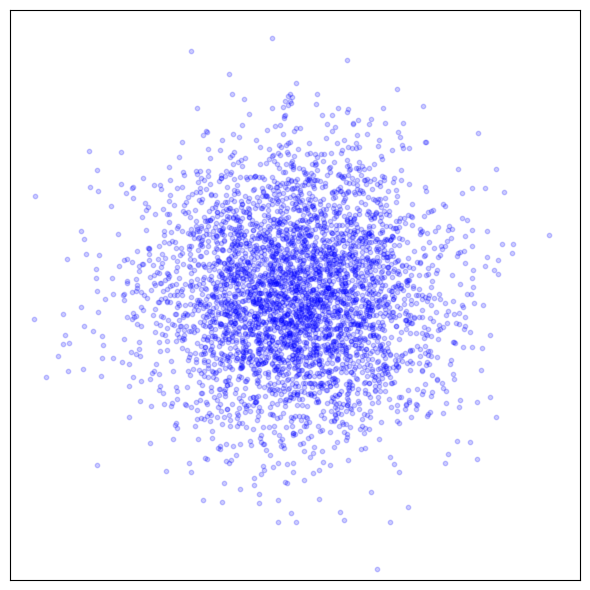

In [3]:
def generate_gaussian(n_dims, num_points, noise_std=1.0):
    """
    Generate an n-dimensional independent Gaussian distribution with specified variance.
    """
    return torch.randn(num_points, n_dims) * (noise_std)

# Generate samples with different variances
sigma_i = 1.0
num_points = 4000
gaussian_samples1 = generate_gaussian(n_dims=2, num_points=num_points, noise_std=sigma_i)  # Default variance
checkerboard_samples = generate_checkerboard(num_points, grid_size=5, scale=1.5)

# Initial and final distributions
initial_dist = gaussian_samples1
final_dist = checkerboard_samples

x_lim_params = (-4, 4)
y_lim_params = (-4, 4)

# Plot the distributions
plt.figure(figsize=(12, 6))

# Plot Gaussian distribution with variance=1.0
plt.subplot(1, 2, 1)
plt.scatter(initial_dist[:, 0].numpy(), initial_dist[:, 1].numpy(), 
            c='blue', alpha=0.2, s=10)
plt.title('2D Gaussian (Var=1.0)')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim(x_lim_params)  
plt.ylim(y_lim_params)  
plt.grid(True)

# Plot Spiral distribution
plt.subplot(1, 2, 2)
plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(), 
            c='red', alpha=0.2, s=10)
plt.title('Checkboard Distribution')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim(x_lim_params)  
plt.ylim(y_lim_params)  
plt.grid(True)

plt.tight_layout()
plt.show()

print (final_dist.shape)
plt.figure(figsize=(6, 6))
plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(), 
            c='red', alpha=0.2, s=10)
plt.xlim((-2, 2))  
plt.ylim((-2, 2))  
plt.grid(True)
plt.xticks([])  # Remove x-axis ticks
plt.yticks([])  # Remove y-axis ticks
plt.tight_layout()
plt.savefig("imgs/checkerboard.png")

plt.figure(figsize=(6, 6))
plt.scatter(initial_dist[:, 0].numpy(), initial_dist[:, 1].numpy(), 
            c='blue', alpha=0.2, s=10)
plt.xlim((-4, 4))  
plt.ylim((-4, 4))  
plt.grid(True)
plt.xticks([])  # Remove x-axis ticks
plt.yticks([])  # Remove y-axis ticks
plt.tight_layout()
plt.savefig("imgs/gauss.png")

# Using The Analytical Flow

In [4]:
# Run integration
start_time = time.time()

trajectory = forward_euler_integration_analytic_linear(
    initial_points=initial_dist,
    data=final_dist,
    t_start=0.0,
    t_end=1.0, 
    num_steps=100,
    sigma_i=sigma_i
)

# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Integration completed in {elapsed_time:.4f} seconds")


Integration completed in 41.8328 seconds


In [5]:
# Create the folder if it doesn't exist
output_dir = 'imgs/checkerboard'
os.makedirs(output_dir, exist_ok=True)

steps_to_plot = [0, 20, 40, 60, 80, 100]
for i, step in enumerate(steps_to_plot):
    current_time = step / max(steps_to_plot)
    current_points = trajectory[step]
    
    plt.figure(figsize=(4, 4))
    plt.scatter(current_points[:, 0].cpu().numpy(), current_points[:, 1].cpu().numpy(),
                c='blue', alpha=0.2, s=10, label='Current Points')
    plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(),
                c='red', alpha=0.1, s=5, label='Target Distribution')
    
    plt.title(f'Time t = {current_time:.2f}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.xlim(x_lim_params)  
    plt.ylim(y_lim_params)  
    plt.grid(True)    
    plt.tight_layout()
    
    # Save the image
    filename = f'{output_dir}/step_{step}.png'
    plt.savefig(filename)
    
    # Close the figure to avoid overlap
    plt.close()

## Animated GIF

In [6]:
def animate_trajectory(trajectory, final_dist):
    fig, ax = plt.subplots(figsize=(6, 6))
    
    # Initialize scatter plots
    current_scatter = ax.scatter([], [], c='blue', alpha=0.2, s=10, label='Current Points')
    target_scatter = ax.scatter(final_dist[:, 0], final_dist[:, 1], c='red', alpha=0.1, s=5, label='Target Distribution')
    
    ax.set_xlim(x_lim_params)
    ax.set_ylim(y_lim_params)
    ax.grid(True)
    ax.legend()
    
    def update(frame):
        current_scatter.set_offsets(trajectory[frame])
        ax.set_title(f'Time t = {frame/(len(trajectory)-1):.2f}')
        return current_scatter,
    
    ani = FuncAnimation(fig, update, frames=len(trajectory), interval=50, blit=True)
    plt.close()
    return ani

os.makedirs('imgs', exist_ok=True)

# Create animation and save
start_time = time.time()
ani = animate_trajectory(trajectory.numpy(), final_dist.numpy())
ani.save('imgs/checkerboard_analytic.gif', writer='pillow', fps=20, dpi=80)
# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Gif made in {elapsed_time:.4f} seconds")

# To display in Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())

Gif made in 19.4352 seconds


# Machine Learning Solution

Having demonstrated our exact solution, we now implement a machine learning solution to the flow-matching problem with a fully connected neural network.

## Training

In [7]:
# Define the Flow model
class Flow(nn.Module):
    def __init__(self, dim: int = 2, h: int = 128):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(dim + 1, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, h), nn.SiLU(),
            nn.Linear(h, dim))
    
    def forward(self, t: Tensor, x_t: Tensor) -> Tensor:
        return self.net(torch.cat((t, x_t), -1))

# Set device at the beginning (once)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize model and optimizer
flow = Flow().to(device)
optimizer = torch.optim.AdamW(flow.parameters(), lr=1e-3)
loss_fn = nn.MSELoss()

# Training loop
batch_size = 2048
n_epochs = 30000

initial_dist_ml = initial_dist.to(device)
final_dist_ml = final_dist.to(device)

# Training loop with device awareness
start_time = time.time()
for epoch in range(n_epochs):
    # Random batch indices - created on target device directly
    idx_0 = torch.randperm(num_points, device=device)[:batch_size]  # Input indices
    idx_1 = torch.randperm(num_points, device=device)[:batch_size]  # Output indices
    
    x_0 = initial_dist_ml[idx_0]  # Random batch from input distribution
    x_1 = final_dist_ml[idx_1]  # Random batch from output distribution
    
    # Random time points - created on target device
    t = torch.rand(batch_size, 1, device=device)
    
    x_t = (1 - t) * x_0 + t * x_1
    dx_t = x_1 - x_0
    
    # Forward pass
    optimizer.zero_grad()
    pred = flow(t, x_t)  # Model is on device
    loss = loss_fn(pred, dx_t)
    loss.backward()
    optimizer.step()
    
    if epoch % 2000 == 0:
        print(f"Epoch {epoch}, Loss: {loss.item():.4f}")

elapsed_time = time.time() - start_time
print(f"Training completed in {elapsed_time:.4f} seconds")

Epoch 0, Loss: 1.8557
Epoch 2000, Loss: 1.3882
Epoch 4000, Loss: 1.3948
Epoch 6000, Loss: 1.3413
Epoch 8000, Loss: 1.3513
Epoch 10000, Loss: 1.3440
Epoch 12000, Loss: 1.3396
Epoch 14000, Loss: 1.3613
Epoch 16000, Loss: 1.3378
Epoch 18000, Loss: 1.3235
Epoch 20000, Loss: 1.3386
Epoch 22000, Loss: 1.3166
Epoch 24000, Loss: 1.3094
Epoch 26000, Loss: 1.2775
Epoch 28000, Loss: 1.3002
Training completed in 109.7714 seconds


## Visualization

In [8]:
def forward_euler_integration_model(
    initial_points: torch.Tensor,  # [m, d]
    flow_model: nn.Module,          # Trained Flow model
    t_start: float = 0.0,           # Typically 0
    t_end: float = 1.0,             # Typically 1
    num_steps: int = 100,           # Integration steps
    save_trajectory: bool = True    # Whether to store full trajectory
) -> torch.Tensor:

    dt = (t_end - t_start) / num_steps
    current_points = initial_points.clone()
    
    if save_trajectory:
        trajectory = torch.zeros(num_steps + 1, *initial_points.shape, 
                               device=initial_points.device)
        trajectory[0] = current_points.clone()
    
    current_time = t_start
    
    for step in range(1, num_steps + 1):
        # Compute velocity from learned model
        with torch.no_grad():  # Disable gradients for integration
            t_tensor = torch.full((current_points.shape[0], 1), current_time,
                                device=current_points.device)
            velocity = flow_model(t_tensor, current_points)
        
        # Euler update
        current_points = current_points + velocity * dt
        current_time = current_time + dt
        
        if save_trajectory:
            trajectory[step] = current_points.clone()
    
    return trajectory if save_trajectory else current_points

In [9]:
start_time = time.time()

trajectory_model = forward_euler_integration_model(
    initial_points=initial_dist_ml,
    flow_model=flow,
    t_start=0.0,
    t_end=1.0,
    num_steps=100
)

# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Integration completed in {elapsed_time:.4f} seconds")

Integration completed in 0.0739 seconds


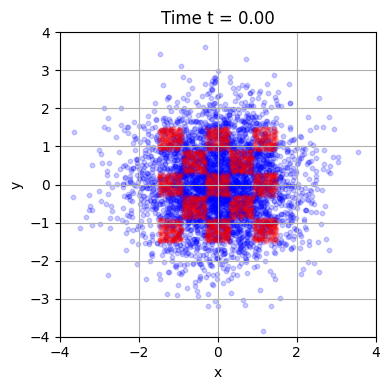

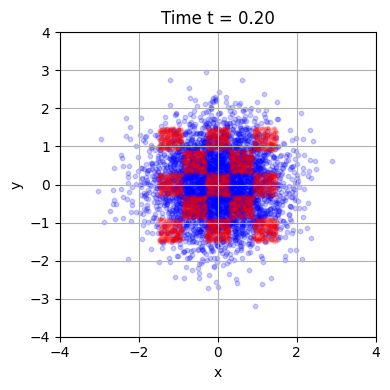

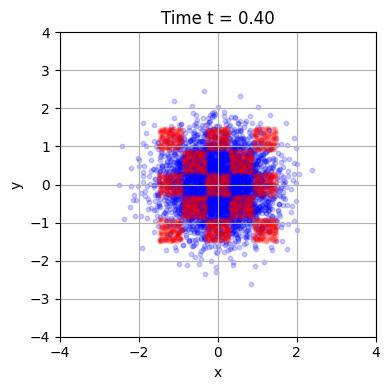

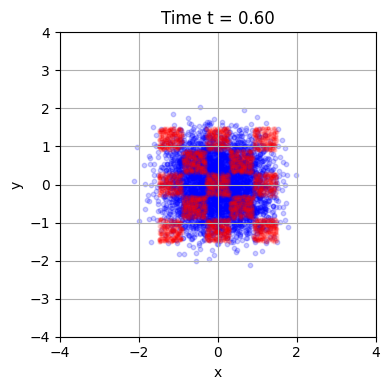

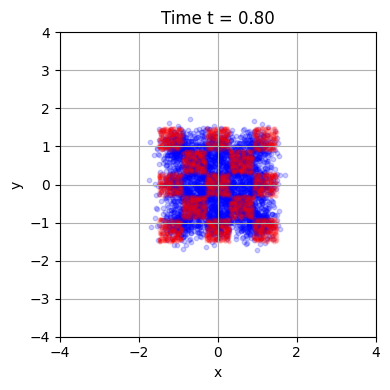

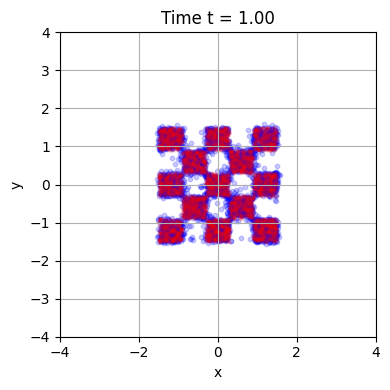

In [10]:
steps_to_plot = [0, 20, 40, 60, 80, 100]
for i, step in enumerate(steps_to_plot):
    current_time = step/max(steps_to_plot)
    current_points = trajectory_model[step]
    
    plt.figure(figsize=(4, 4))
    plt.scatter(current_points[:, 0].cpu().numpy(), current_points[:, 1].cpu().numpy(),
               c='blue', alpha=0.2, s=10, label='Current Points')
    plt.scatter(final_dist[:, 0].numpy(), final_dist[:, 1].numpy(),
               c='red', alpha=0.1, s=5, label='Target Distribution')
    
    plt.title(f'Time t = {current_time:.2f}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.xlim(x_lim_params)  
    plt.ylim(y_lim_params)  
    plt.grid(True)    
    plt.tight_layout()
    plt.show()

## Animated GIF - Machine Learning

In [11]:
def animate_trajectory(trajectory, final_dist):
    fig, ax = plt.subplots(figsize=(6, 6))
    
    # Initialize scatter plots
    current_scatter = ax.scatter([], [], c='blue', alpha=0.2, s=10, label='Current Points')
    target_scatter = ax.scatter(final_dist[:, 0], final_dist[:, 1], c='red', alpha=0.1, s=5, label='Target Distribution')
    
    ax.set_xlim(x_lim_params)
    ax.set_ylim(y_lim_params)
    ax.grid(True)
    ax.legend()
    
    def update(frame):
        current_scatter.set_offsets(trajectory[frame])
        ax.set_title(f'Time t = {frame/(len(trajectory)-1):.2f}')
        return current_scatter,
    
    ani = FuncAnimation(fig, update, frames=len(trajectory), interval=50, blit=True)
    plt.close()
    return ani

# Create animation
start_time = time.time()
ani = animate_trajectory(trajectory_model.cpu().numpy(), final_dist.numpy())
# Or to save as GIF:
ani.save('imgs/flow_matching_model.gif', writer='pillow', fps=20, dpi=80)
# Calculate elapsed time
elapsed_time = time.time() - start_time
print(f"Gif made in {elapsed_time:.4f} seconds")

# To display in Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())

Gif made in 19.4682 seconds


# Theoretical Minimum Loss

Since we have the velocity that minimizes the flow-matching training objective, we can also numerically compute the minimum loss and compare the ones observed in the training of our machine learning model. Furthermore, we can plot this loss as a function of t, to see if velocities at certain t values are harder to estimate than others.

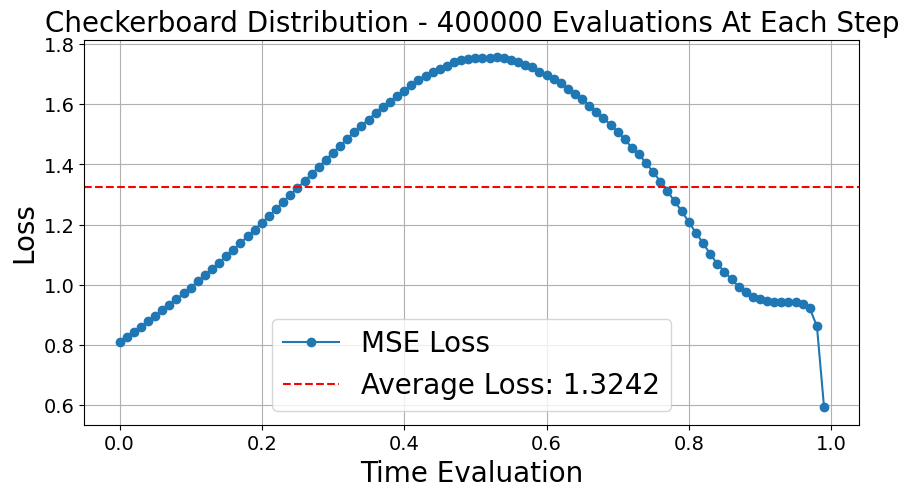

The average loss for our optimal velocity field was  1.3241946160793305


In [12]:
# Initialize storage for losses
time_points = np.arange(0, 1.0, 0.01)
losses = np.zeros(len(time_points))  # Store average losses
n_trials = 100  # Number of trials to average over at each time point

for i, time_eval in enumerate(time_points):
    trial_losses = []
    
    for _ in range(n_trials):
        # Random batch indices
        idx_0 = torch.randperm(num_points, device=device)
        idx_1 = torch.randperm(num_points, device=device)
        
        x_0 = initial_dist_ml[idx_0]
        x_1 = final_dist_ml[idx_1]
        
        # Fixed time points
        t = torch.full((num_points, 1), time_eval, device=device)
        
        x_t = (1 - t) * x_0 + t * x_1
        dx_t = x_1 - x_0
        
        # Forward pass
        pred = compute_linear_velocity_batch(x_t, final_dist_ml, time_eval, sigma_i)
        loss = loss_fn(pred, dx_t)
        trial_losses.append(loss.detach().cpu().numpy())
    
    # Store average loss for this time point
    losses[i] = np.mean(trial_losses)

# Convert to numpy array
losses = np.array(losses)

# Plotting
plt.figure(figsize=(10, 5))
plt.plot(time_points, losses, 'o-', label='MSE Loss')
plt.xlabel('Time Evaluation', fontsize = 20)
plt.ylabel('Loss', fontsize = 20)
plt.title(f'Checkerboard Distribution - {n_trials*num_points} Evaluations At Each Step', fontsize = 20)
plt.grid(True)

# Add average loss line
avg_loss = np.mean(losses)
plt.axhline(avg_loss, color='r', linestyle='--', label=f'Average Loss: {avg_loss:.4f}')
plt.tick_params(axis='both', which='major', labelsize=14) 
plt.legend(fontsize = 20)
plt.savefig('imgs/loss_checkerboard.png', bbox_inches='tight', dpi=300) 
plt.show()

print ("The average loss for our optimal velocity field was ", avg_loss)